In [42]:
%matplotlib inline

import os
import glob
import numpy as np
from numpy.fft import fft, ifft, fftfreq
import pandas as pd
import matplotlib.pyplot as plt
from matplotlib import gridspec
from matplotlib.animation import FuncAnimation
import seaborn as sns
from nltools.data import Brain_Data, Adjacency
from nltools.mask import expand_mask, roi_to_brain
from nltools.stats import isc, isfc, isps, fdr, threshold, phase_randomize, circle_shift, _butter_bandpass_filter, _phase_mean_angle, _phase_vector_length
from nilearn.plotting import view_img_on_surf, view_img
from sklearn.metrics import pairwise_distances
from sklearn.utils import check_random_state
from scipy.stats import ttest_1samp
from scipy.signal import hilbert
import networkx as nx
from IPython.display import HTML
import warnings
import brainiak.isc

# import nest_asyncio
# nest_asyncio.apply()
import datalad.api as dl

warnings.simplefilter('ignore')

## Get Dataset using datalad

In [5]:
data_dir = '/Users/naeun-oh/Sherlock'

# If dataset hasn't been installed, clone from GIN repository
if not os.path.exists(data_dir):
    dl.clone(source='https://gin.g-node.org/ljchang/Sherlock', path=data_dir)

# Initialize dataset
ds = dl.Dataset(data_dir)

ds.status(annex='all')

untracked: fmriprep/sub-02/.DS_Store (file)
1350 annex'd files (25.1 GB/109.0 GB present/total size)


[{'type': 'file',
  'state': 'untracked',
  'path': '/Users/naeun-oh/Sherlock/fmriprep/sub-02/.DS_Store',
  'parentds': '/Users/naeun-oh/Sherlock',
  'status': 'ok',
  'refds': '/Users/naeun-oh/Sherlock',
  'action': 'status'},
 {'type': 'file',
  'gitshasum': '116d8bb34495b9b29570fa721cf70646b1d06cfd',
  'prev_gitshasum': '116d8bb34495b9b29570fa721cf70646b1d06cfd',
  'state': 'clean',
  'backend': 'MD5E',
  'bytesize': 6148,
  'hashdirlower': '627/833/',
  'hashdirmixed': '12/jJ/',
  'humansize': '6.15 kB',
  'key': 'MD5E-s6148--e8f8f6fb9d5df8b366cc7eb5581bb74f',
  'keyname': 'e8f8f6fb9d5df8b366cc7eb5581bb74f',
  'mtime': 'unknown',
  'has_content': False,
  'path': '/Users/naeun-oh/Sherlock/.DS_Store',
  'parentds': '/Users/naeun-oh/Sherlock',
  'status': 'ok',
  'refds': '/Users/naeun-oh/Sherlock',
  'action': 'status'},
 {'type': 'file',
  'gitshasum': 'b540820107ca5718dc0f196a08edf3729239bfef',
  'bytesize': 125,
  'prev_gitshasum': 'b540820107ca5718dc0f196a08edf3729239bfef',
  's

## Intersubject Correlation
We will compute ISC on average activity within 50 ROIs, which is already extracted in csv files for all participants.
We will use the pairwise method to compute ISC for each ROI.

In [4]:
# Get Cropped & Denoised CSV Files
result = ds.get(glob.glob(os.path.join(data_dir, 'fmriprep', '*', 'func', f'*Average_ROI*csv')))

get(ok): fmriprep/sub-08/func/sub-08_Part2_Average_ROI_n50.csv (file) [from origin...]
get(ok): fmriprep/sub-02/func/sub-02_Part1_Average_ROI_n50.csv (file) [from origin...]
get(ok): fmriprep/sub-10/func/sub-10_Part1_Average_ROI_n50.csv (file) [from origin...]
get(ok): fmriprep/sub-15/func/sub-15_Part1_Average_ROI_n50.csv (file) [from origin...]
get(ok): fmriprep/sub-16/func/sub-16_Part2_Average_ROI_n50.csv (file) [from origin...]
get(ok): fmriprep/sub-16/func/sub-16_Part1_Average_ROI_n50.csv (file) [from origin...]
get(ok): fmriprep/sub-09/func/sub-09_Part2_Average_ROI_n50.csv (file) [from origin...]
get(ok): fmriprep/sub-14/func/sub-14_Part1_Average_ROI_n50.csv (file) [from origin...]
get(ok): fmriprep/sub-13/func/sub-13_Part2_Average_ROI_n50.csv (file) [from origin...]
get(ok): fmriprep/sub-12/func/sub-12_Part2_Average_ROI_n50.csv (file) [from origin...]
get(ok): fmriprep/sub-01/func/sub-01_Part2_Average_ROI_n50.csv (file) [from origin...]
get(ok): fmriprep/sub-03/func/sub-03_Part2_

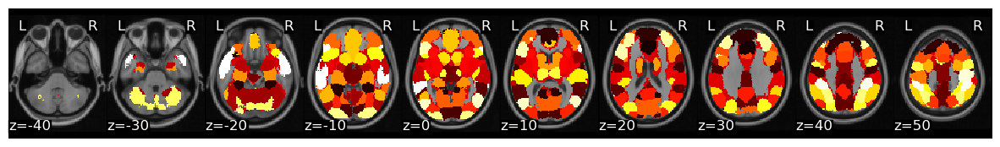

In [10]:
# ROI mask : 
# download the k=50 whole brain meta-analytic parcellation of the neurosynth database (de la Vega, 2016) from neurovault
mask = Brain_Data('http://neurovault.org/media/images/2099/Neurosynth%20Parcellation_0.nii.gz')

# Each ROI is indicated with a unique integer
# The whole mask is expanded into 50 separate binary masks with expand_mask()
mask_x = expand_mask(mask)

mask.plot()

In [8]:
# You can practice extracting average ROI data but it's been done for you already
for scan in ['Part1', 'Part2']:
    file_list = glob.glob(os.path.join(data_dir, 'fmriprep', '*', 'func', f'*crop*{scan}*hdf5'))
    for f in file_list:
        sub = os.path.basename(f).split('_')[0]
        print(sub)
        data = Brain_Data(f)
        roi = data.extract_roi(mask)
        pd.DataFrame(roi.T).to_csv(os.path.join(os.path.dirname(f), f"{sub}_{scan}_Average_ROI_n50.csv" ), index=False)

sub-13


PermissionError: [Errno 13] Permission denied: '/Users/naeun-oh/Sherlock/fmriprep/sub-13/func/sub-13_Part1_Average_ROI_n50.csv'

In [9]:
# Load the csv files for each participant and save into dict
sub_list = [os.path.basename(x).split('_')[0] for x in glob.glob(os.path.join(data_dir, 'fmriprep', '*', 'func', '*Part1*csv'))]
sub_list.sort()

sub_timeseries = {}
for sub in sub_list:
    part1 = pd.read_csv(os.path.join(data_dir, 'fmriprep', sub, 'func', f'{sub}_Part1_Average_ROI_n50.csv'))
    part2 = pd.read_csv(os.path.join(data_dir, 'fmriprep', sub, 'func', f'{sub}_Part2_Average_ROI_n50.csv'))
    sub_data = part1.append(part2)
    sub_data.reset_index(inplace=True, drop=True)
    sub_timeseries[sub] = sub_data

,sub-01,sub-02,sub-03,sub-04,sub-05,sub-06,sub-07,sub-08,sub-09,sub-10,sub-11,sub-12,sub-13,sub-14,sub-15,sub-16
0,3.362605,-1.967253,-0.243505,2.527032,5.166227,-0.678549,2.199253,-1.646883e+00,0.421235,0.500547,0.361623,4.639737e+00,1.490442,1.806639,1.039467,3.483579e-13
1,0.995695,1.730923,1.552836,1.068784,4.066954,0.117737,3.184899,8.464993e-01,-0.118011,0.981400,-0.069505,2.522244e+00,1.145760,-0.582861,-0.420722,-1.237187e-13
2,2.084567,-1.940155,1.914897,1.103097,2.168681,0.030628,2.036096,1.782011e-01,0.984125,3.957482,-0.792416,1.326291e+00,0.472309,-3.066318,0.869296,-1.931528e-02
3,-0.217049,-0.636084,1.501459,-0.701397,1.704406,0.042397,2.353035,1.088203e+00,1.650786,3.687806,3.839885,2.105321e-02,-2.885314,-1.212683,1.213115,-1.460159e+00
4,-2.628723,1.650023,-1.196258,0.079026,1.297944,-0.743593,1.188282,3.375227e-13,1.515944,-0.709527,4.874887,2.279356e-13,-5.277045,0.232831,1.914874,1.745742e+00


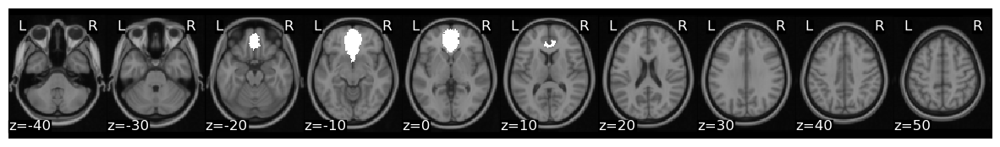

In [13]:
# Create new pandas DataFrame that has average vmPFC activity for each participant
roi = 32

mask_x[roi].plot()

def get_subject_roi(data, roi):
    sub_rois = {}
    for sub in data:
        sub_rois[sub] = data[sub].iloc[:, roi]
    return pd.DataFrame(sub_rois)

sub_rois = get_subject_roi(sub_timeseries, roi)
sub_rois.head()
# sub_rois size: voxels x subjects

## Hypothesis Testing on ISC
To perform ISC we will use nltools.stats.isc()
To perform hypothesis tests, we will implement three different non-parametric methods: circular shifting data, phase randomization, subject-wise bootstrap

### Circular Shifting
First, the idea behind circular shifting data is to generate random surrogate data that has the same autoregressive and temporal properties of the original data (Lancaster et al., 2018). This involves randomly selecting a time point to become the new beginning of the timeseries and then concatenating the rest of the data at the end so that it has the same length as the original data. Of course, there wil potentially be a sudden change in the data where the two parts were merged.

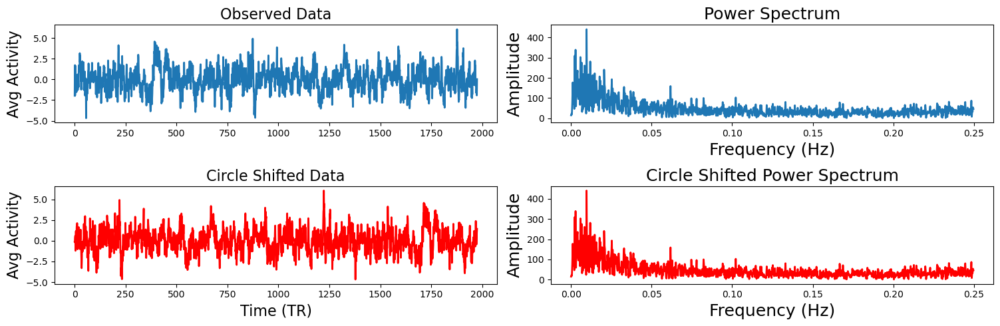

In [19]:
# Plot one subject's time series and shift it using nltools.stats.circle_shift()
# Plot the coefficients from a fast fourier transform (shows frequency)
sub = 'sub-02'
sampling_freq = .5

f,a = plt.subplots(nrows=2, ncols=2, figsize=(15, 5))
a[0,0].plot(sub_rois[sub], linewidth=2)
a[0,0].set_ylabel('Avg Activity', fontsize=16)
a[0,1].set_xlabel('Time (TR)', fontsize=18)
a[0,0].set_title('Observed Data', fontsize=16)

fft_data = fft(sub_rois[sub])
freq = fftfreq(len(fft_data), 1/sampling_freq)
n_freq = int(np.floor(len(fft_data)/2))
a[0,1].plot(freq[:n_freq], np.abs(fft_data)[:n_freq], linewidth=2)
a[0,1].set_xlabel('Frequency (Hz)', fontsize=18)
a[0,1].set_ylabel('Amplitude', fontsize=18)
a[0,1].set_title('Power Spectrum', fontsize=18)

circle_shift_data = circle_shift(sub_rois[sub])
a[1,0].plot(circle_shift_data, linewidth=2, color='red')
a[1,0].set_ylabel('Avg Activity', fontsize=16)
a[1,0].set_xlabel('Time (TR)', fontsize=16)
a[1,0].set_title('Circle Shifted Data', fontsize=16)

fft_circle = fft(circle_shift_data)
a[1,1].plot(freq[:n_freq], np.abs(fft_circle)[:n_freq], linewidth=2, color='red')
a[1,1].set_xlabel('Frequency (Hz)', fontsize=18)
a[1,1].set_ylabel('Amplitude', fontsize=18)
a[1,1].set_title('Circle Shifted Power Spectrum', fontsize=18)

plt.tight_layout()

In [20]:
# Compute ISC of vmPFC roi with 5000 permutations.
# isc() outputs a dictionary that contains ISC values, p-value, 95% confidence intervals, optimally returns 5000 samples
# parallel run
stats_circle = isc(sub_rois, method='circle_shift', n_bootstraps=5000, return_bootstraps=True)

print(f"ISC: {stats_circle['isc']:.02}, p = {stats_circle['p']:.03}")

ISC: 0.074, p = 0.0002


### Phase Randomization
Second, phase randomization projects the data into frequency space using a fast fourier transform, preserves the Fourier amplitudes but randomizes the Fourier phases(angle representing the fraction of the cycle covered, e.g. 90deg), and then projects the data back into the time domain (Theiler et al., 1992, Lancaster et al., 2018). Similar to the circular shifting method, this generates a random surrogate of the data, while maintaining a similar temporal and autoregressive structure as the original data.

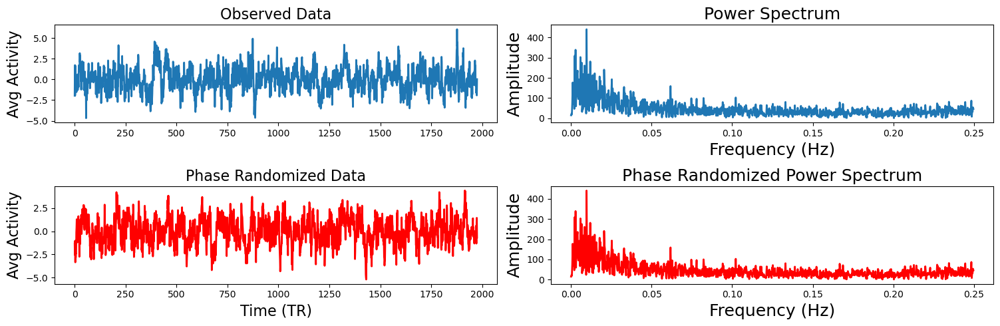

In [21]:
# We will generate the same plots from above using nltools.stats.phase_randomize()
sub = 'sub-02'
sampling_freq = .5

f,a = plt.subplots(nrows=2, ncols=2, figsize=(15, 5))
a[0,0].plot(sub_rois[sub], linewidth=2)
a[0,0].set_ylabel('Avg Activity', fontsize=16)
a[0,1].set_xlabel('Time (TR)', fontsize=18)
a[0,0].set_title('Observed Data', fontsize=16)

fft_data = fft(sub_rois[sub])
freq = fftfreq(len(fft_data), 1/sampling_freq)
n_freq = int(np.floor(len(fft_data)/2))
a[0,1].plot(freq[:n_freq], np.abs(fft_data)[:n_freq], linewidth=2)
a[0,1].set_xlabel('Frequency (Hz)', fontsize=18)
a[0,1].set_ylabel('Amplitude', fontsize=18)
a[0,1].set_title('Power Spectrum', fontsize=18)

phase_random_data = phase_randomize(sub_rois[sub])
a[1,0].plot(phase_random_data, linewidth=2, color='red')
a[1,0].set_ylabel('Avg Activity', fontsize=16)
a[1,0].set_xlabel('Time (TR)', fontsize=16)
a[1,0].set_title('Phase Randomized Data', fontsize=16)

fft_phase = fft(phase_random_data)
a[1,1].plot(freq[:n_freq], np.abs(fft_phase)[:n_freq], linewidth=2, color='red')
a[1,1].set_xlabel('Frequency (Hz)', fontsize=18)
a[1,1].set_ylabel('Amplitude', fontsize=18)
a[1,1].set_title('Phase Randomized Power Spectrum', fontsize=18)

plt.tight_layout()

In [23]:
# Compute ISC of vmPFC roi with 5000 permutations.
stats_phase = isc(sub_rois, method='phase_randomize', n_bootstraps=10000, return_bootstraps=True)

print(f"ISC: {stats_phase['isc']:.02}, p = {stats_phase['p']:.03}")

ISC: 0.074, p = 0.0001


ISC values (median of the pairwise correlations) of the two permutation methods are identical. The p-values are also similar and likely reflect the limited precision of the possible p-values that can be computed using only 5000 permutations. For greater precision, increase the number of permutations but this will take longer to compute.

### Subject-wise Bootstrapping
Third, subject-wise bootstrapping is more conservative than the previously described permutation methods and is almost an order of magnitude faster shuffling the similarity matrix compared to recomputing the pairwise similarity for the null distribution (Chen et al., 2016). 
Bootstrapping vs Permutation
Bootstrapping is typically used more for generating confidence intervals around an estimator, while permutation tests are used for performing hypothesis tests. However, p-values can also be computed using a bootstrap by subtracting the ISC from the null distribution and evaluating the percent of samples from the distribution that are smaller than the ISC (hall et al., 1991).

We illustrate what an example bootstrapped similarity matrix looks like.
Due to resampling with replacement, some subjects are repeatedly resampled and there are multiple values of perfect correlations found off the diagonal. 
This can be accounted for by using the median summary statistic of the lower triangle. However, Brainiak and nltools toolboxes convert these values to NaNs to minimize the impact of these outliers on the summary statistic.

Text(0.5, 1.0, 'Bootstrapped Pairwise Similarity')

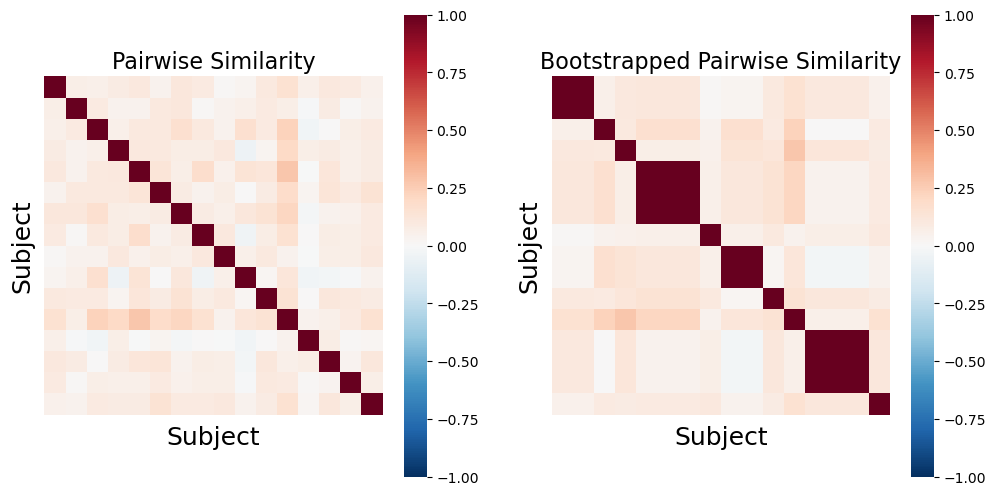

In [24]:
def bootstrap_subject_matrix(similarity_matrix, random_state=None):
    '''This function shuffles subjects within a similarity matrix based on recommendation by Chen et al., 2016'''
    
    random_state = check_random_state(random_state)
    n_sub = similarity_matrix.shape[0]
    bootstrap_subject = sorted(random_state.choice(np.arange(n_sub), size=n_sub, replace=True))
    return similarity_matrix[bootstrap_subject, :][:, bootstrap_subject]


similarity = 1 - pairwise_distances(pd.DataFrame(sub_rois).T, metric='correlation')

f,a = plt.subplots(ncols=2, figsize=(12, 6), sharey=True)
sns.heatmap(similarity, square=True, cmap='RdBu_r', vmin=-1, vmax=1, xticklabels=False, yticklabels=False, ax=a[0])
a[0].set_ylabel('Subject', fontsize=18)
a[0].set_xlabel('Subject', fontsize=18)
a[0].set_title('Pairwise Similarity', fontsize=16)

sns.heatmap(bootstrap_subject_matrix(similarity), square=True, cmap='RdBu_r', vmin=-1, vmax=1, xticklabels=False, yticklabels=False, ax=a[1])
a[1].set_ylabel('Subject', fontsize=18)
a[1].set_xlabel('Subject', fontsize=18)
a[1].set_title('Bootstrapped Pairwise Similarity', fontsize=16)

In [25]:
stats_boot = isc(sub_rois, method='bootstrap', n_bootstraps=5000, return_bootstraps=True)

print(f"ISC: {stats_boot['isc']:.02}, p = {stats_boot['p']:.03}")

ISC: 0.074, p = 0.0002


Now that we saved the null distributions, we can plot a histogram of the null distribution from each method including the confidence intervals. 

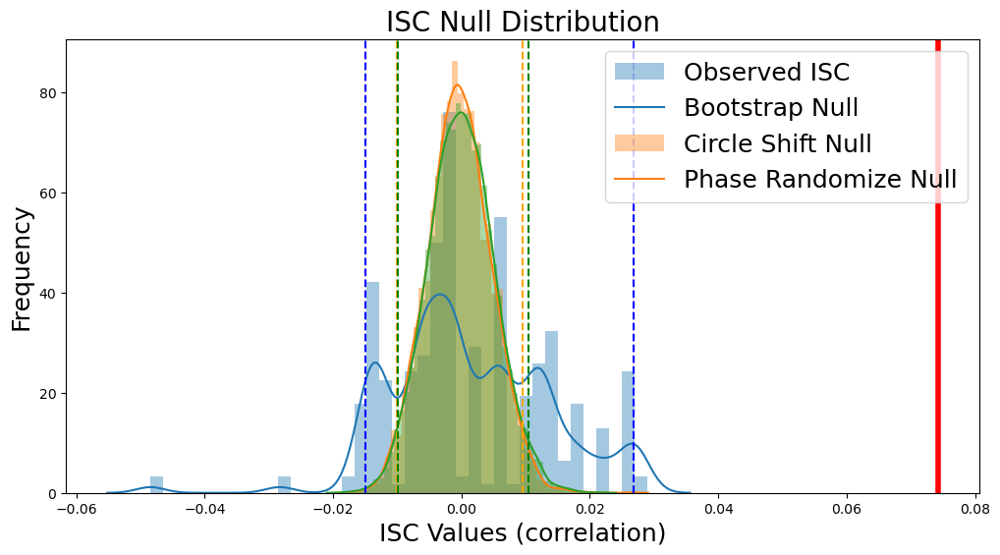

In [26]:
plt.figure(figsize=(12,6))
sns.distplot(stats_boot['null_distribution'] - stats_boot['isc'], kde=True, label='Bootstrap')
sns.distplot(stats_circle['null_distribution'], kde=True, label='Bootstrap')
sns.distplot(stats_phase['null_distribution'], kde=True, label='Bootstrap')
plt.ylabel('Frequency', fontsize=18)
plt.xlabel('ISC Values (correlation)', fontsize=18)
plt.title('ISC Null Distribution', fontsize=20)
plt.axvline(stats_boot['isc'], linestyle='-', color='red', linewidth=4)
plt.legend(['Observed ISC', 'Bootstrap Null','Circle Shift Null', 'Phase Randomize Null'], fontsize=18)

plt.axvline(stats_boot['ci'][0] - stats_boot['isc'], linestyle='--', color='blue')
plt.axvline(stats_boot['ci'][1] - stats_boot['isc'], linestyle='--', color='blue')

plt.axvline(stats_circle['ci'][0], linestyle='--', color='orange')
plt.axvline(stats_circle['ci'][1], linestyle='--', color='orange')

plt.axvline(stats_phase['ci'][0], linestyle='--', color='green')
plt.axvline(stats_phase['ci'][1], linestyle='--', color='green')

Notice that the circle shift and phase randomization methods produce highly similar null distributions and confidence intervals.
, while the bootstrap method has a wider and less symmetric distribution with the current number of iterations. 
However, the observed ISC of 0.074 (red line) exceeds all of the samples from the null distribution yielding a very small p-value. 

Now, let's calculate ISC looping over each of the 50 ROIs from the whole-brain.

In [27]:
# Loop over each ROI and grab the column from each subject's dataframe : get_subject_roi()
# Run ISC on the combined subject's ROI timeseries using the median method and compute hypothesis test using subject-wise bootstrap with 5000 samples : isc()
# Convert each correlation and p-value from each region back into Brain_Data instance : roi_to_brain()
isc_r, isc_p = {}, {}
for roi in range(50):
    stats = isc(get_subject_roi(sub_timeseries, roi), n_bootstraps=5000, metric='median', method='bootstrap')
    isc_r[roi], isc_p[roi] = stats['isc'], stats['p']
isc_r_brain, isc_p_brain = roi_to_brain(pd.Series(isc_r), mask_x), roi_to_brain(pd.Series(isc_p), mask_x)

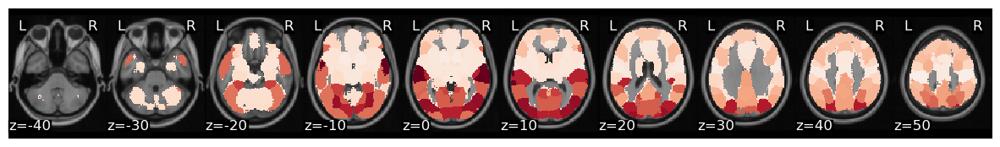

In [29]:
# Plot the ISC values to visualize which regions had a higher overall ISC
isc_r_brain.plot(cmap='RdBu_r')


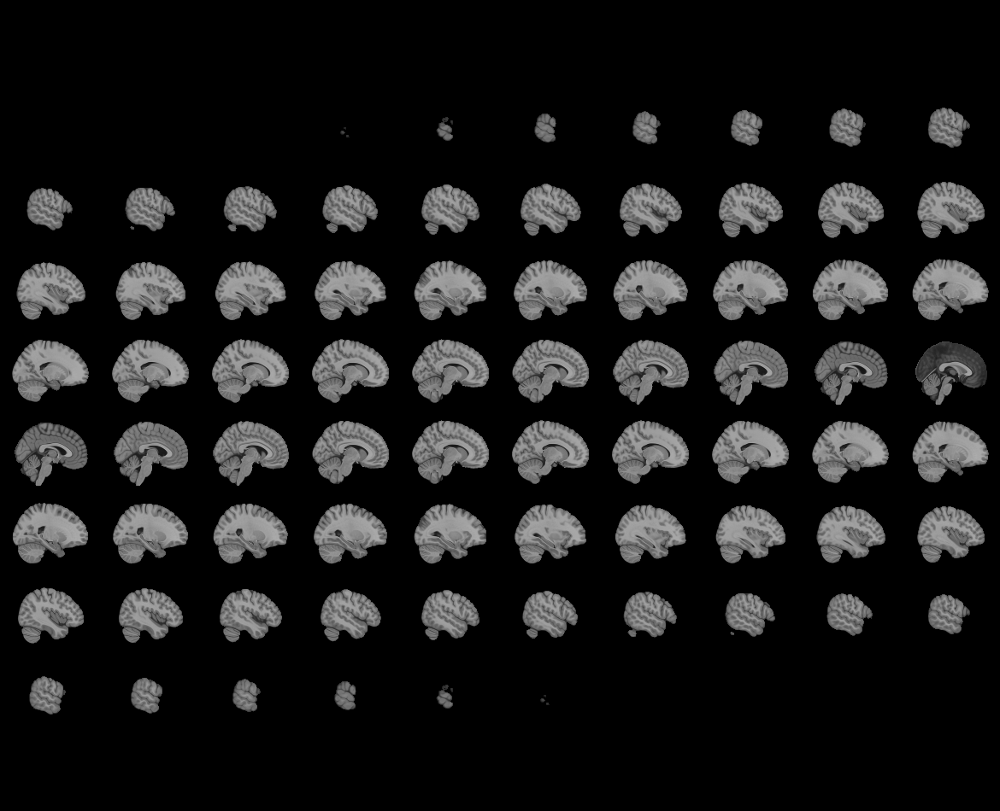
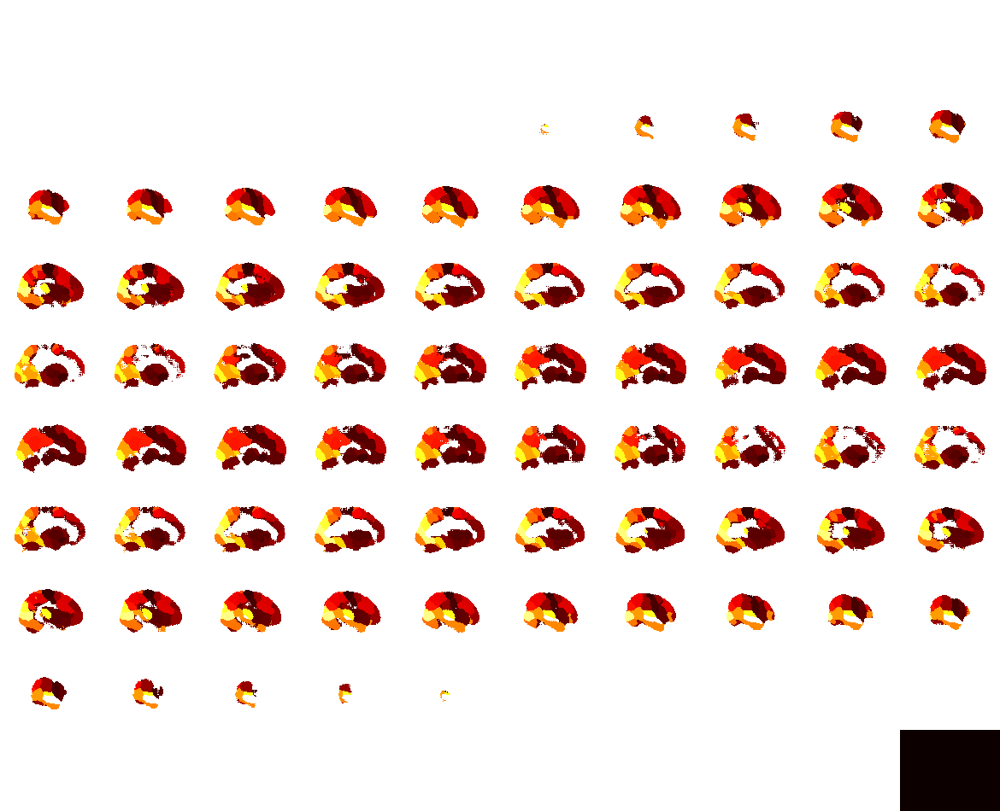

In [30]:
view_img(isc_r_brain.to_nifti())

Now, let's threshold using bonferroni correction (p<0.001 for k=50 parcellation). Alternatively, we can threshold using false discovery rate by setting thr=fdr(isc_p_brain.data).
Here, FDR is more conservative than bonferroni (try for yourself!).

In [34]:
view_img_on_surf(threshold(isc_r_brain, isc_p_brain, thr=.001).to_nifti())
#view_img_on_surf(threshold(isc_r_brain, isc_p_brain, thr=fdr(isc_p_brain.data)).to_nifti())

## Intersubject Functional Connectivity
We demonstrate how to perform ISFC using the averaging method. We iterate over each subject and compute the cross-correlation between each of the target subject's ROIs with the average ROI response of the other subjects. This yields a separate ROI x ROI ISFC matrix for each subject. We use nltools.stats.isfc() but check out the Brainiak implementation for a faster and more feature rich option. I will do both :)

Plot the average of these ROI x ROI ISFC matrices as a heatmap.
The diagonal reflects the ROI's ISC using the averaging method (rather than the pairwise method in the previous examples). 
Off diagonal values reflect the average ISFC between each ROI.

Text(96.78333333333339, 0.5, 'ROI')

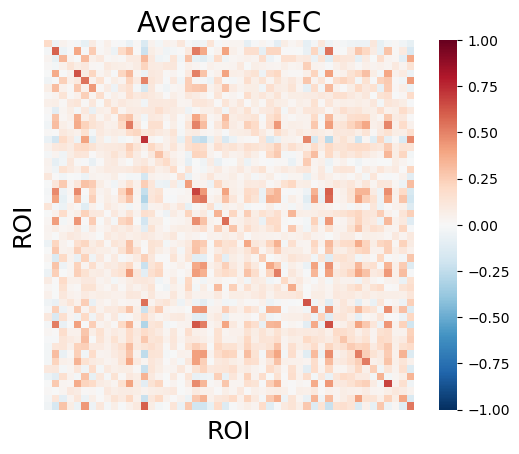

In [55]:
data = list(sub_timeseries.values())

isfc_output = isfc(data)
#isfc_output = brainiak.isc.isfc(data)

sns.heatmap(np.array(isfc_output).mean(axis=0), vmin=-1, vmax=1, square=True, cmap='RdBu_r', xticklabels=False, yticklabels=False)
plt.title('Average ISFC', fontsize=20)
plt.xlabel('ROI', fontsize=18)
plt.ylabel('ROI', fontsize=18)

We can threshold the ISFC matrix by running a one-sample t-test on each ISFC value and correcting for multiple comparisons using FDR.
We can convert this into an adjacency matrix, by binarizing the continuous t-values. In this example, we are interested in exploring which regions have a positive ISFC. Thus, we use an arbitrary fdr threshold (q<0.000001) in this example to create a sparse adjacency matrix.

Text(96.78333333333339, 0.5, 'ROI')

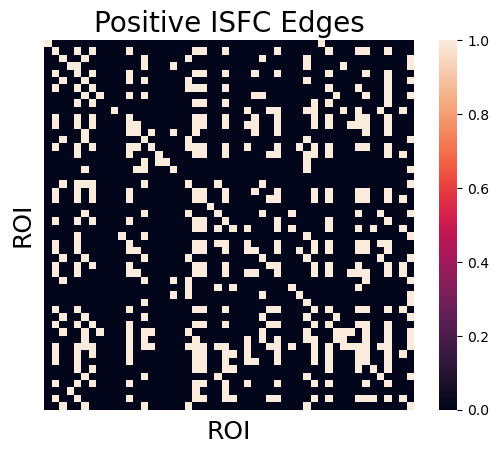

In [36]:
t, p = ttest_1samp(np.array([x.reshape(-1) for x in isfc_output]), 0)
thresh = fdr(p, .0000001)
thresholded_t_pos = t.copy()
thresholded_t_pos[p > thresh] = 0
thresholded_t_pos[thresholded_t_pos <= 0] = 0
thresholded_t_pos[thresholded_t_pos > 0] = 1
thresholded_t_pos = np.reshape(thresholded_t_pos, isfc_output[0].shape)

sns.heatmap(thresholded_t_pos, square=True, xticklabels=False, yticklabels=False)
plt.title('Positive ISFC Edges', fontsize=20)
plt.xlabel('ROI', fontsize=18)
plt.ylabel('ROI', fontsize=18)

We can now convert this adjacency matrix into a graph and can visualize which regions are functionally connected to the most other regions.

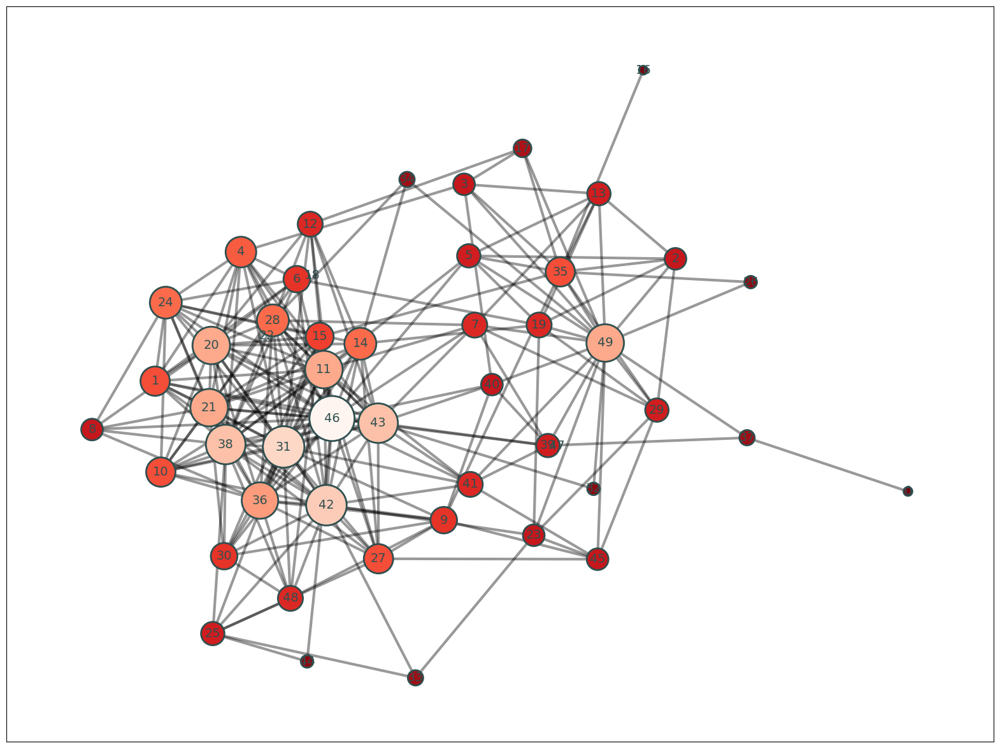

In [37]:
def plot_network(data):
    '''Plot the degree of the thresholded isfc Adjaceny matrix'''
    
    if not isinstance(data, Adjacency):
        raise ValueError('data must be an Adjacency instance.')
        
    plt.figure(figsize=(20,15))
    G = data.to_graph()
    pos = nx.kamada_kawai_layout(G)
    node_and_degree = G.degree()
    nx.draw_networkx_edges(G, pos, width=3, alpha=.4)
    nx.draw_networkx_labels(G, pos, font_size=14, font_color='darkslategray')

    nx.draw_networkx_nodes(G, pos, nodelist=list(dict(node_and_degree).keys()),
                           node_size=[x[1]*100 for x in node_and_degree],
                           node_color=list(dict(node_and_degree).values()),
                           cmap=plt.cm.Reds_r, linewidths=2, edgecolors='darkslategray', alpha=1)
    
plot_network(Adjacency(thresholded_t_pos, matrix_type='similarity'))

To interpret this, let's project the number of connections (i.e. degree) with each node back into brain space.

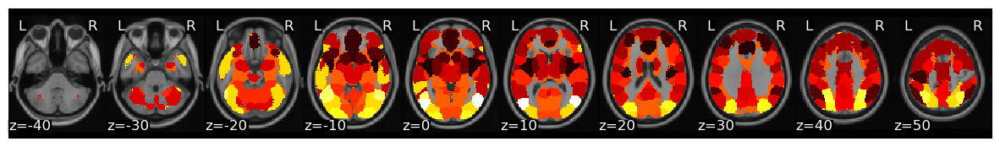

In [38]:
degree = pd.Series(dict(Adjacency(thresholded_t_pos, matrix_type='similarity').to_graph().degree()))
brain_degree = roi_to_brain(degree, mask_x)
brain_degree.plot()

In [39]:
view_img_on_surf(brain_degree.to_nifti())

## Temporal Dynamics of Intersubject Synchrony
This section will help you build an intuition for the core concepts behind intersubject phase synchrony (ISPS). We will begin by creating an animation of the phase angles.

First, we will compute the instantaneous phase angle of average ROI activity for each subject. We will use an infinite impulse response (IIR) bandpass butterworth filter. This requires specifying the sampling_frequency in cycles per second (Hz) which is 1/tr, and lower and upper cutoff frequencies also in Hz. Then we will apply a hilbert transform and extract the phase angle for each time point.

Here, we extract signal from primary auditory cortex(roi 35) which we assume will synchronize strongly across participants, and use a lower bound cutoff frequency of 0.04Hz and an upper bound of 0.07Hz as recommended by Glerean et al. (2012).

In [56]:
roi = 35
tr = 1.5
lowcut = .04
highcut = .07

phase_angles = np.angle(hilbert(_butter_bandpass_filter(get_subject_roi(sub_timeseries, roi), lowcut, highcut, 1/tr), axis=0))

To visualize data, we will plot 100 TRs of each participant's phase angles from the auditory cortex using a polar plot. 
For some time points all subjects have a different phase angle. These time points should have low synchrony values (i.e. resultant vector length close to zero). 
Other time points the phase angles will cluster together and all face the same direction. These time points will have high phase synchrony (i.e. resultant vector length close to one).
We can also comput the mean phase angle for the group using circular statistics (red line). We don't care so much about the mean angle bu rather the **length of the resultant vector**. This is our metric of intersubject phase clustering, or the degree to which participants are in phase with each other at a given time point. Notice how the length gets shorter the more participants are our of phase and longer when they are all facing the same direction.

In [57]:
xs, ys = [], []

fig = plt.figure(constrained_layout=False, figsize=(10,10))
spec = gridspec.GridSpec(ncols=4, nrows=4, figure=fig)

a0 = fig.add_subplot(spec[:2, :2], projection='polar')
plt.polar([0, _phase_mean_angle(phase_angles[0,:])], [0,1], color='red', linewidth=3)

a1 = fig.add_subplot(spec[:2, 2:4], projection='polar')
plt.polar([0, phase_angles[0,0]], [0,1], color='navy', linewidth=1, alpha=.2)

a2 = fig.add_subplot(spec[2:, :])
a2.plot(_phase_vector_length(phase_angles))
a2.set_ylabel('Phase Synchrony', fontsize=18)
a2.set_xlabel('Time (TRs)', fontsize=18)

def animate(i, xs, ys):
    xs = np.linspace(0, i, i+1, endpoint=True)
    ys = phase_angles[:i+1, :]
    
    a0.clear()
    a0.plot([0, _phase_mean_angle(phase_angles[i,:])], [0, _phase_vector_length(phase_angles[i,:])], color='red', linewidth=3)
    a0.set_title('Mean Phase Angle', fontsize=18)
    a0.set_ylim([0,1])
    
    a1.clear()
    for j in range(ys.shape[1]):
        a1.plot([0, phase_angles[i,j]], [0,1], color='navy', alpha=.5)  
    a1.set_title('Subject Phase Angles', fontsize=18)

    a2.clear()
    a2.plot(xs, _phase_vector_length(ys))
    a2.set_ylim([0,1])
    a2.set_ylabel('Resultant Vector Length', fontsize=18)
    a2.set_xlabel('Time (TRs)', fontsize=18)
    a2.set_title('Intersubject Phase Synchrony', fontsize=18)
    plt.tight_layout()
    
animation = FuncAnimation(fig, animate, fargs=(xs, ys), frames=range(100,200), interval=100, blit=False)
plt.close(animation._fig)
HTML(animation.to_jshtml())

Animation size has reached 21139735 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


<Figure size 640x480 with 0 Axes>

Now, let's pick a frequency band and plot the average phase synchrony over the entire 50min Sherlock viewing within each ROI from out parcellation. Let's continue using a lower bound cutoff frequency of 0.04Hz and an upper bound of 0.07Hz.

We loop over each ROI and compute average ISPS over time and then project back into brain space.

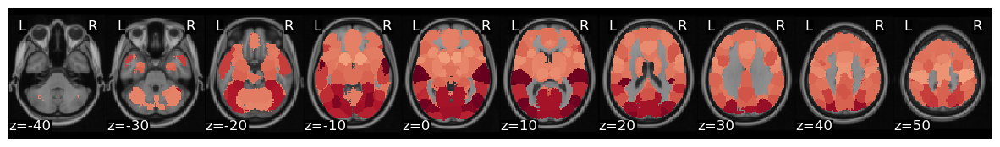

In [58]:
cutoff = (0.04, 0.07)
synchrony = {}
for roi in range(50):
    synchrony[roi] = isps(get_subject_roi(sub_timeseries, roi), low_cut=cutoff[0], high_cut=cutoff[1], sampling_freq=1/tr, order=5)['vector_length']
synchrony = pd.DataFrame(synchrony)

phase_synchrony_brain = roi_to_brain(pd.DataFrame(synchrony).mean(), mask_x)
phase_synchrony_brain.plot(cmap='RdBu_r')

In [59]:
# Create an interactive surface rendering
view_img_on_surf(phase_synchrony_brain.to_nifti())

You can see that these results look very similar to the whole timeseries ISC apporach we used above. High overall synchrony across participants within primary auditory and visual cortices and lower overall synchrony in prefrontal and limbic regions.

Previously, we looked at a specific frequency band (0.04-0.07Hz). It's possible that participants might differently synchronize within different frequency bands (Honey et al., 2012; Kauppi et al., 2010). 
Let's create a time-frequency plot to see how ISPS changes over time within different frequency for a given ROI. We will explore the dorsomedial prefrontal cortex (roi 2).

We will loop over different cutoff bands. These values are based on the slow frequency bands described in Buszaki & Draguhun (2003) and Zuo et al. (2010), but are admittedly somewhat arbitrarily selected. Brighter colors indicate time points that have a higher level of ISPS within a specific TR.

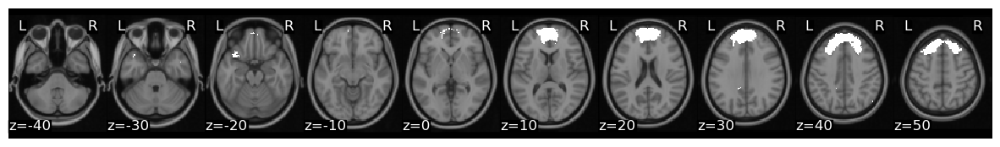

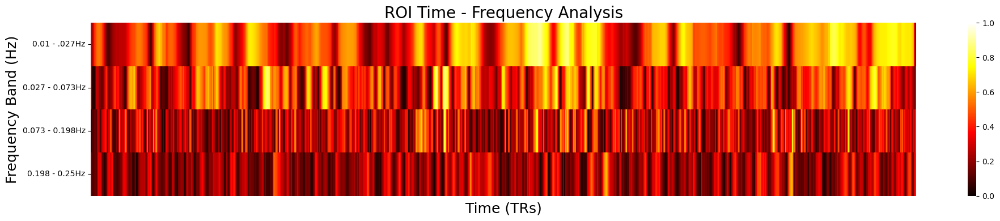

In [60]:
tr = 1.5
roi = 2

frequencies = [(0.01, 0.027),(0.027, 0.073),(0.073, 0.198),(0.198, 0.25)]

time_freq = {}
for i,cutoff in enumerate(frequencies):
    time_freq[i] = isps(get_subject_roi(sub_timeseries, roi), low_cut=cutoff[0], high_cut=cutoff[1], sampling_freq=1/tr, order=5)['vector_length']
    
time_freq = pd.DataFrame(time_freq).T
pd.DataFrame(time_freq).index = ['0.01 - .027Hz','0.027 - 0.073Hz','0.073 - 0.198Hz','0.198 - 0.25Hz']

mask_x[roi].plot()
f,a = plt.subplots(nrows=1, figsize=(20, 4))
sns.heatmap(time_freq, cmap='hot', vmin=0, vmax=1, xticklabels=False, ax=a)
a.set_title('ROI Time - Frequency Analysis', fontsize=20)
a.set_ylabel('Frequency Band (Hz)', fontsize=18)
a.set_xlabel('Time (TRs)', fontsize=18)
plt.tight_layout()

Hypothesis test

Statistics for time-varying measures of synchrony largely follow a similar non-parametric approach as discussed above. However, depending on the values used, statistics of phase synchrony differ slightly from linear measures of synchrony. In particular, circular statistics (Fisher, 1995) can be used to estimate the parametric statistics of phase differences on the unit circle, as wrapping of the phase angle (change the range of angle) cause the angular difference to change signs as the signals rotate around the circle.

For a parametric test, we use the Rayleigh test to determine if the ISPS is statistically significant, by testing the null hypothesis that the phase angles are uniformly distributed around a circle (Fisher, 1995). If the phase angles cluster together in specific direction, they will have a large resultant vector and we can rejct the null uniformity hypothesis.

Let's simulate what ISPS values would be significant at p<0.05 given the sample size of N=16 in the Sherlock dataset. 
Plot the estimated p-values using the Rayleigh test across ISPS values ranging from [0,1].

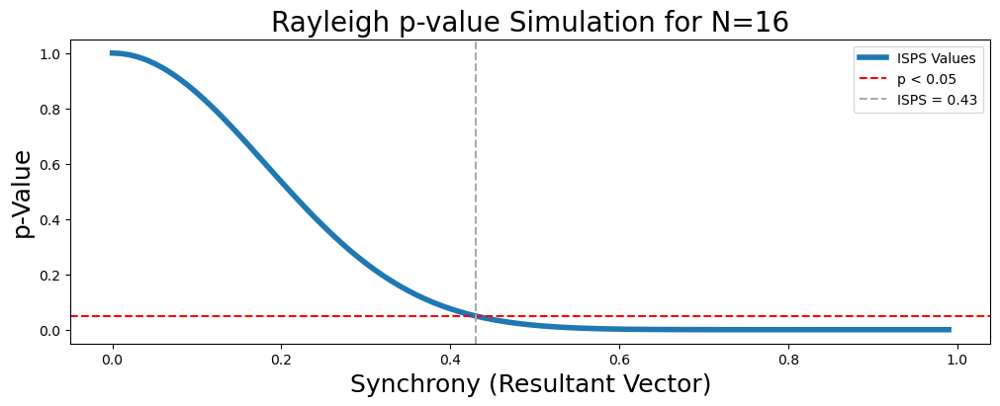

In [61]:
n = 16
R = np.arange(0,1, .01)
Z = n*(R**2)

p = np.exp(-1*Z)*(1 + (2*Z - Z**2)/(4*n) - (24*Z - 132*Z**2 +76*Z**3 - 9*Z**4)/(288*n**2))

plt.figure(figsize=(12, 4))
plt.plot(R, p, linewidth=4)
plt.axhline(.05, linestyle='--', color='red')
plt.axvline(.43, linestyle='--', color='darkgrey')
plt.ylabel('p-Value', fontsize=18)
plt.xlabel('Synchrony (Resultant Vector)', fontsize=18)
plt.title('Rayleigh p-value Simulation for N=16', fontsize=20)
plt.legend(['ISPS Values', 'p < 0.05', 'ISPS = 0.43'])

For N=16, an ISPS value of 0.43 corresponds to a significance value of approximately p<0.05. This number will decrease as the number of participants increases and approaches the central limit theorem like any significance test.

Note that you will need to consider controlling for multiple comparisons when repeated testing the same hypothesis across either space or time.

Now, let's put this all together and compute ISPS at different frequency bands thresholding at a very liberal threshold of p<0.05.

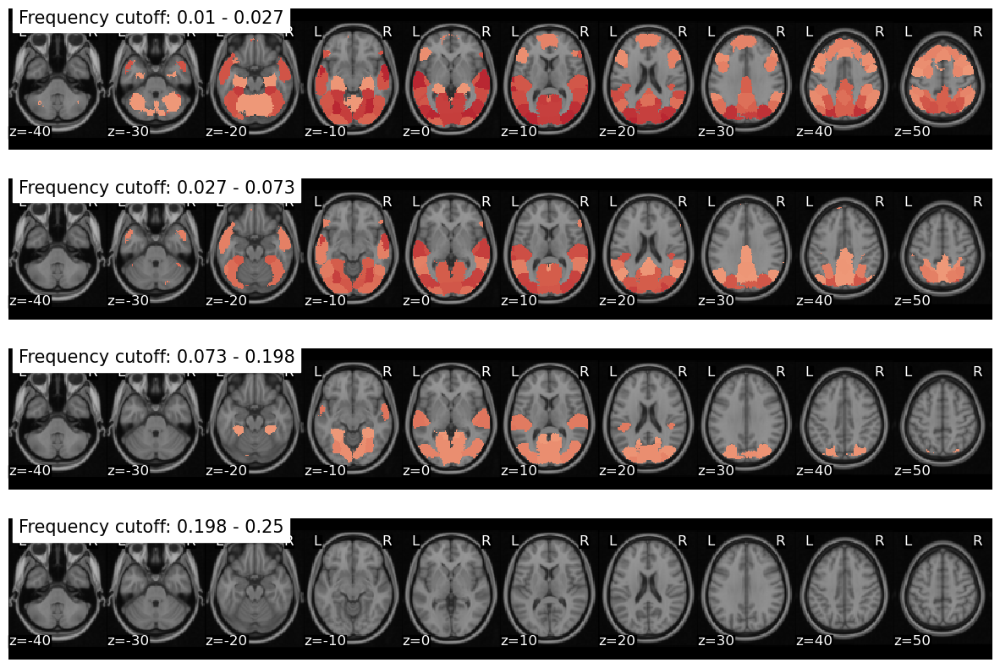

In [62]:
f,a = plt.subplots(nrows = len(frequencies), figsize=(15,10))
for i,cutoff in enumerate(frequencies):
    synchrony = {}
    for roi in range(50):
        synchrony[roi] = isps(get_subject_roi(sub_timeseries, roi), low_cut=cutoff[0], high_cut=cutoff[1], sampling_freq=1/tr, order=5)['vector_length']
    phase_synchrony_brain = roi_to_brain(pd.DataFrame(synchrony).mean(), mask_x)
    phase_synchrony_brain.plot(cmap='RdBu_r', vmax=1, axes=a[i], threshold=.43, title=f"Frequency cutoff: {cutoff[0]} - {cutoff[1]}")

ISPS Functional Connectivity Analysis.

There are lots of interesting potential analysis made possible by dynamic conenctivity measures such as ISPS, and a very exploratory ISPS functional connectivity analysis.

Here, we will explore which brain regions have a similar shared dynamic synchrony while watching Sherlock. Note that this is slightly different to the ISFC analysis above as we are calculating the similarity of local synchrony rather similarity of brain activity directly. We simply compute the **pairwise temporal similarity of each ROI's ISPS time series.** We can threshold these correlations with an arbitrary threshold to create a sparse adjency matrix.

**Thoughts:** I am a bit skeptical about interpreting this metric. ISPS represents how similar time-varying brain activities are among participants for each ROI. Then, we compute the pairwise temporal similarity of those similarities for all ROIs. This does not seem to be a true metric of how similarity of activity timecourses between ROIs (FC) are dynamically synchronized between participants. Instead, the time-varying FC should be calculated for each subject and then

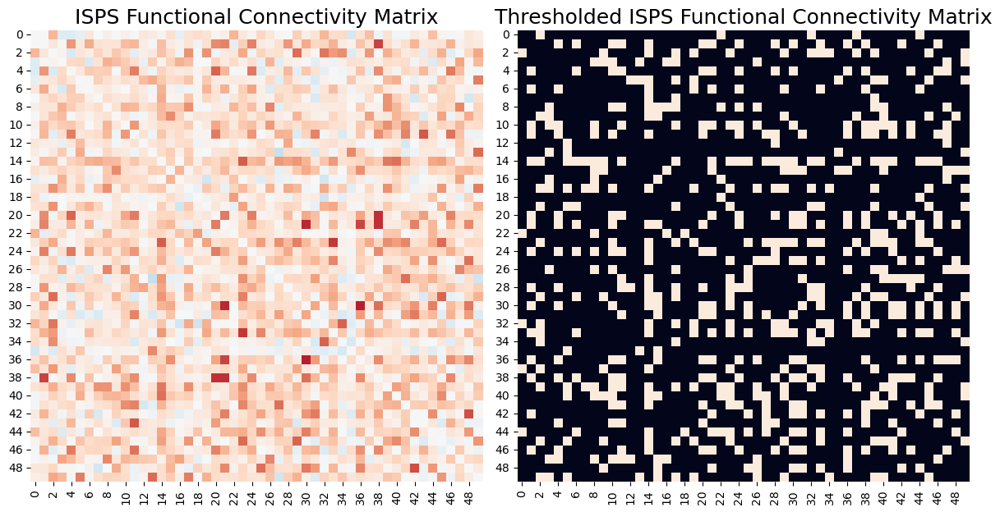

In [63]:
synchrony = {}
for roi in range(50):
    stats = isps(get_subject_roi(sub_timeseries, roi), low_cut=0.01, high_cut=0.027, sampling_freq=1/tr)
    synchrony[roi] = stats['vector_length']
synchrony = pd.DataFrame(synchrony)

sync = Adjacency(1 - pairwise_distances(synchrony.T, metric='correlation'), matrix_type='similarity')

f,a = plt.subplots(ncols=2, figsize=(12, 6))

sync.plot(vmin=-1, vmax=1, cmap='RdBu_r', axes=a[0], cbar=False)
sync.threshold(upper = .25, binarize=True).plot(axes=a[1], cbar=False)
a[0].set_title('ISPS Functional Connectivity Matrix', fontsize=18)
a[1].set_title('Thresholded ISPS Functional Connectivity Matrix', fontsize=18)
plt.tight_layout()

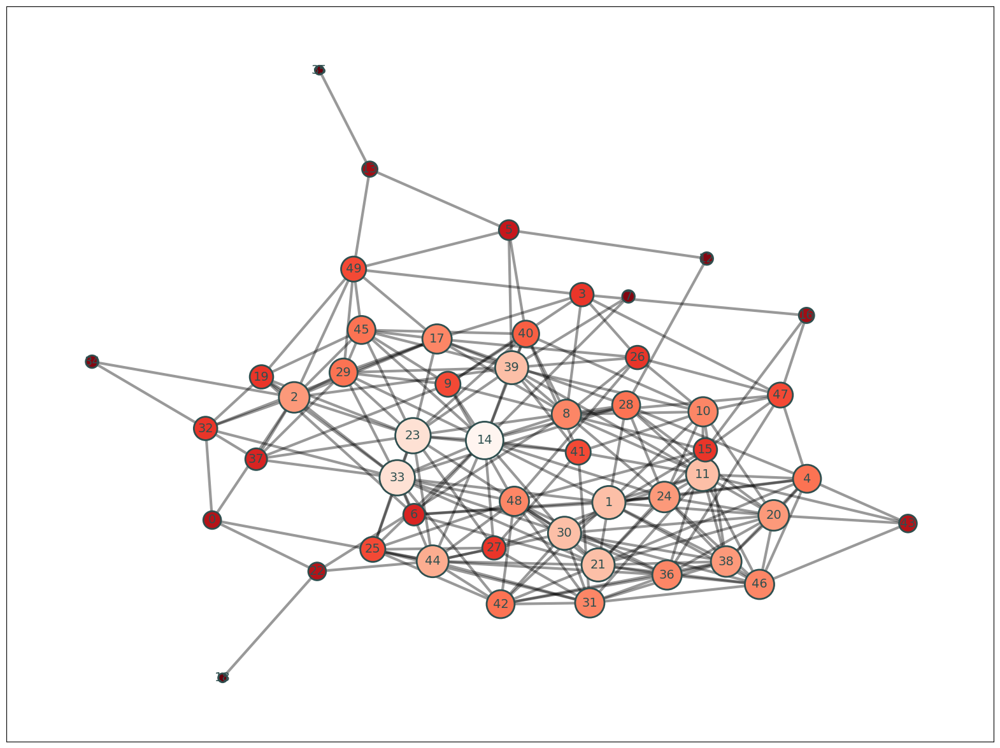

In [65]:
# Create a graph of the thresholded edges using the networkx package
plot_network(sync.threshold(upper = .3, binarize=True))

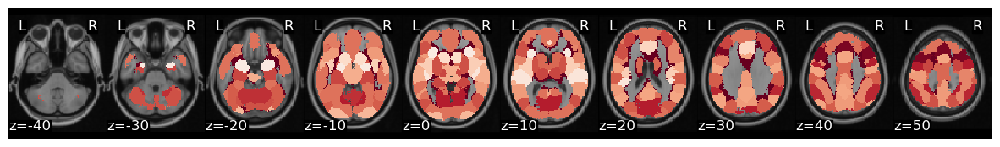

In [66]:
# Calculate the degree for each node and project back into brain space
degree = pd.Series(dict(sync.threshold(upper=.2, binarize=True).to_graph().degree()))
brain_degree = roi_to_brain(degree, mask_x)
brain_degree.plot(cmap='RdBu_r')